# **PHASE-1**

In [ ]:
import tensorflow as tf
from tensorflow.keras.datasets import cifar10
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping

# Load CIFAR-10 dataset
(x_train, y_train), (x_test, y_test) = cifar10.load_data()

# Normalize the data
x_train, x_test = x_train / 255.0, x_test / 255.0

# One-hot encode the labels
y_train = tf.keras.utils.to_categorical(y_train, 10)
y_test = tf.keras.utils.to_categorical(y_test, 10)


model = Sequential([
    Conv2D(64, (3, 3), activation='relu', padding='same', input_shape=(32, 32, 3)),
    BatchNormalization(),
    Conv2D(64, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),

    Conv2D(128, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),

    Conv2D(256, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(256, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),

    Conv2D(512, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(512, (3, 3), activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),

    Flatten(),
    Dense(512, activation='relu'),
    BatchNormalization(),
    Dropout(0.5),
    Dense(512, activation='relu'),
    BatchNormalization(),
    Dropout(0.5),
    Dense(10, activation='softmax')
])

model.compile(optimizer=Adam(learning_rate=0.0001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

early_stopping = EarlyStopping(monitor='val_accuracy', patience=10, restore_best_weights=True)


history = model.fit(x_train, y_train, epochs=100, batch_size=64,
                    validation_split=0.2, callbacks=[early_stopping])


170498071/170498071 [==============================] - 5s 0us/step
Epoch 1/100
625/625 [==============================] - 31s 29ms/step - loss: 2.1961 - accuracy: 0.3534 - val_loss: 1.6290 - val_accuracy: 0.4293
Epoch 2/100
625/625 [==============================] - 16s 26ms/step - loss: 1.5712 - accuracy: 0.4926 - val_loss: 1.1430 - val_accuracy: 0.6035
Epoch 3/100
625/625 [==============================] - 18s 28ms/step - loss: 1.2381 - accuracy: 0.5860 - val_loss: 0.9657 - val_accuracy: 0.6661
Epoch 4/100
625/625 [==============================] - 16s 26ms/step - loss: 1.0328 - accuracy: 0.6467 - val_loss: 0.9255 - val_accuracy: 0.6812
Epoch 5/100
625/625 [==============================] - 16s 26ms/step - loss: 0.8593 - accuracy: 0.7052 - val_loss: 0.8445 - val_accuracy: 0.7151
Epoch 6/100
625/625 [==============================] - 17s 28ms/step - loss: 0.7131 - accuracy: 0.7527 - val_loss: 0.8755 - val_accuracy: 0.7052
Epoch 7/100
625/625 [==============================] - 16s 26ms

In [ ]:
# Evaluate the model on the test set
test_loss, test_accuracy = model.evaluate(x_test, y_test)
print(f'Test accuracy: {test_accuracy}')


313/313 [==============================] - 2s 6ms/step - loss: 1.2112 - accuracy: 0.7976
Test accuracy: 0.7975999712944031


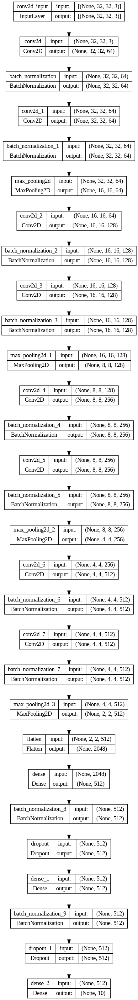

In [ ]:
from tensorflow.keras.utils import plot_model
plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=True)

# **Phase-2**

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import tensorflow as tf
import tensorflow_datasets as tfds
from tensorflow import keras
from tensorflow.keras import layers
from keras import callbacks

In [ ]:
(train_raw, val_raw, test_raw), ds_info = tfds.load(name='oxford_iiit_pet',
                                                    split=['train[:90%]',
                                                          'train[90%:]',
                                                          'test'],
                                                    shuffle_files=True,
                                                    as_supervised=True, # Returns (image, label)
                                                    with_info=True # To retrieve dataset info and label names
                                   )

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/2 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/3680 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/oxford_iiit_pet/incomplete.XJBM8A_3.2.0/oxford_iiit_pet-train.tfrecord*...…

Generating test examples...:   0%|          | 0/3669 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/oxford_iiit_pet/incomplete.XJBM8A_3.2.0/oxford_iiit_pet-test.tfrecord*...:…

Dataset oxford_iiit_pet downloaded and prepared to /root/tensorflow_datasets/oxford_iiit_pet/3.2.0. Subsequent calls will reuse this data.


In [ ]:
ds_info

tfds.core.DatasetInfo(
    name='oxford_iiit_pet',
    full_name='oxford_iiit_pet/3.2.0',
    description="""
    The Oxford-IIIT pet dataset is a 37 category pet image dataset with roughly 200
    images for each class. The images have large variations in scale, pose and
    lighting. All images have an associated ground truth annotation of breed.
    """,
    homepage='http://www.robots.ox.ac.uk/~vgg/data/pets/',
    data_dir=PosixGPath('/tmp/tmptb92t2jrtfds'),
    file_format=tfrecord,
    download_size=773.52 MiB,
    dataset_size=774.69 MiB,
    features=FeaturesDict({
        'file_name': Text(shape=(), dtype=string),
        'image': Image(shape=(None, None, 3), dtype=uint8),
        'label': ClassLabel(shape=(), dtype=int64, num_classes=37),
        'segmentation_mask': Image(shape=(None, None, 1), dtype=uint8),
        'species': ClassLabel(shape=(), dtype=int64, num_classes=2),
    }),
    supervised_keys=('image', 'label'),
    disable_shuffling=False,
    splits={
        '

In [ ]:
train_raw

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>

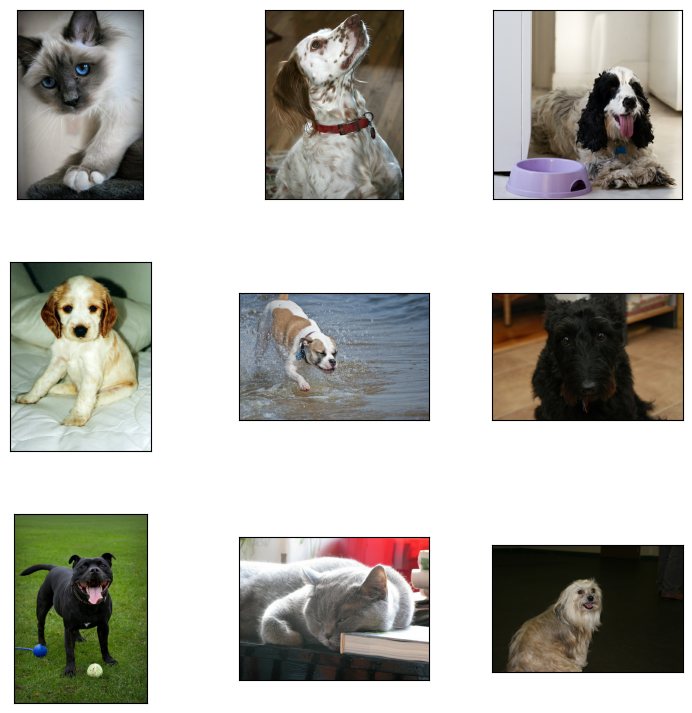

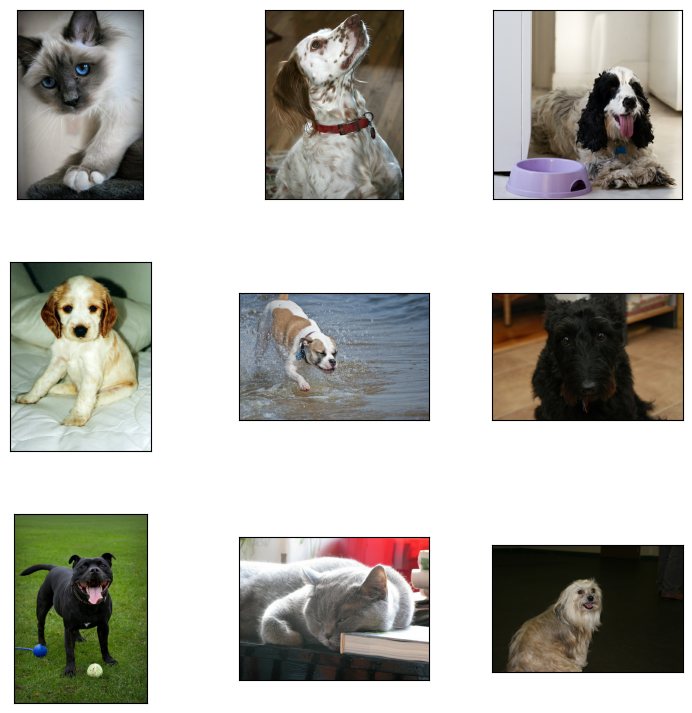

In [ ]:
tfds.show_examples(train_raw, ds_info, image_key='image')

In [ ]:
# Get number of classes
num_classes = ds_info.features['label'].num_classes
print('Number of classes:', num_classes)

Number of classes: 37


In [ ]:
num_train_examples = tf.data.experimental.cardinality(train_raw).numpy()
num_val_examples = tf.data.experimental.cardinality(val_raw).numpy()
num_test_examples = tf.data.experimental.cardinality(test_raw).numpy()

print('Number of training samples:', num_train_examples)
print('Number of validation samples:', num_val_examples)
print('Number of test samples:', num_test_examples)

Number of training samples: 3312
Number of validation samples: 368
Number of test samples: 3669


In [ ]:
def get_value_counts(ds):
    label_list = []
    for images, labels in ds:
        label_list.append(labels.numpy())
    label_counts = pd.Series(label_list).value_counts(sort=True)

    print(label_counts)

In [ ]:
get_value_counts(train_raw)

19    96
20    95
26    94
21    94
18    94
13    93
24    93
23    93
5     92
2     92
35    92
14    92
31    91
4     91
22    91
8     90
10    90
36    90
34    90
27    89
3     88
9     88
16    88
30    88
29    88
1     88
0     88
15    87
28    87
25    86
17    86
32    86
12    86
33    85
7     85
6     84
11    82
Name: count, dtype: int64


In [ ]:
get_label_name = ds_info.features['label'].int2str
# Build the custom function to display image and label name
def view_single_image(ds):
    image, label = next(iter(ds))
    print('Image shape: ', image.shape)
    plt.imshow(image)
    _ = plt.title(get_label_name(label))


Image shape:  (333, 500, 3)


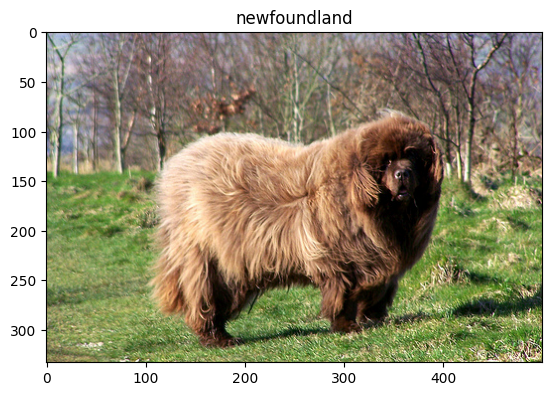

In [ ]:
view_single_image(train_raw)

In [ ]:
train_raw

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>

In [ ]:
IMG_SIZE = 224

train_ds = train_raw.map(lambda x, y: (tf.image.resize(x, (IMG_SIZE, IMG_SIZE)), y))
val_ds = val_raw.map(lambda x, y: (tf.image.resize(x, (IMG_SIZE, IMG_SIZE)), y))
test_ds = test_raw.map(lambda x, y: (tf.image.resize(x, (IMG_SIZE, IMG_SIZE)), y))

In [ ]:
def one_hot_encode(image, label):
    label = tf.one_hot(label, num_classes)
    return image, label

In [ ]:
train_ds = train_ds.map(one_hot_encode)
val_ds = val_ds.map(one_hot_encode)
test_ds = test_ds.map(one_hot_encode)

In [ ]:
train_ds

<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(37,), dtype=tf.float32, name=None))>

## **Data Augmention**

In [ ]:
data_augmentation = tf.keras.Sequential([
    layers.RandomFlip('horizontal'),
    layers.RandomRotation(0.1),
    layers.RandomZoom(0.2),
    layers.RandomContrast(0.2),
    layers.RandomTranslation(height_factor=0.1, width_factor=0.1),
    layers.RandomBrightness(0.2),
])

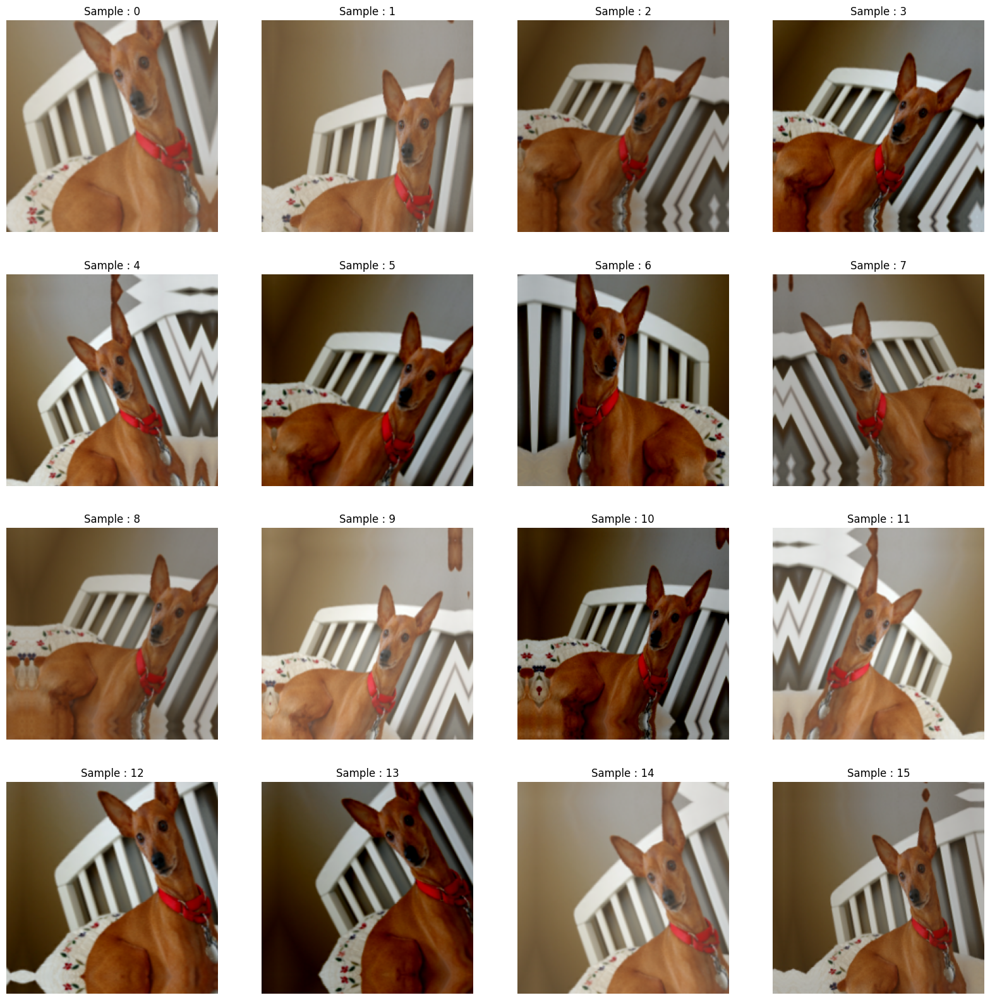

In [ ]:
for image, label in train_ds.take(1):
    plt.figure(figsize=(20, 20))
    for i in range(16):
        ax = plt.subplot(4, 4, i+1)
        aug_img = data_augmentation(tf.expand_dims(image, axis=0))
        plt.imshow(aug_img[0].numpy().astype("uint8"))
        plt.title("Sample : " + str(i))
        plt.axis("off")

In [ ]:
def preprocess_train(image, label):
    image = tf.image.resize(image, [224, 224])  # Resize image to (224, 224)
    image = data_augmentation(image, training=True)  # Apply data augmentation
    return image, label

def preprocess_val (image,label):
    image = tf.image.resize(image, [224, 224])  # Resize image to (224, 224)
    return image, label

# Apply preprocessing to datasets
train_ds_augmented = train_ds.map(preprocess_train, num_parallel_calls=tf.data.AUTOTUNE)
val_ds = val_ds.map(preprocess_val, num_parallel_calls=tf.data.AUTOTUNE)

# Batch and prefetch datasets
train_ds_augmented = train_ds_augmented.batch(32).prefetch(tf.data.AUTOTUNE)
val_ds = val_ds.batch(32).prefetch(tf.data.AUTOTUNE)

In [ ]:
test_ds

<_MapDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(37,), dtype=tf.float32, name=None))>

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam ,RMSprop, SGD
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

model2 = Sequential([
    Conv2D(32, (3, 3), activation='relu', padding='same', input_shape=(224, 224, 3)),
    MaxPooling2D((2, 2)),
    BatchNormalization(),

    Conv2D(64, (3, 3), activation='relu', padding='same'),
    MaxPooling2D((2, 2)),
    BatchNormalization(),

    Conv2D(128, (3, 3), activation='relu', padding='same'),
    MaxPooling2D((2, 2)),
    BatchNormalization(),

    Conv2D(256, (3, 3), activation='relu', padding='same'),
     MaxPooling2D((2, 2)),
    BatchNormalization(),

    Flatten(),
    Dropout(0.3),
    Dense(512, activation='relu'),
    BatchNormalization(),
    Dense(512,activation='relu'),
    BatchNormalization(),
    Dropout(0.3),
    Dense(37, activation='softmax')
])

model2.compile(optimizer = RMSprop(learning_rate=0.001),
              loss='categorical_crossentropy',
              metrics=['CategoricalAccuracy'])

early_stopping = EarlyStopping(monitor='loss', patience=10, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='loss', factor=0.2, patience=4, min_lr=0.00001)

history2 = model2.fit(train_ds_augmented,
                    epochs=100,
                    validation_data=val_ds,
                    callbacks=[early_stopping,reduce_lr])


Epoch 1/100
104/104 [==============================] - 57s 484ms/step - loss: 4.2584 - categorical_accuracy: 0.0456 - val_loss: 19.4549 - val_categorical_accuracy: 0.0435 - lr: 0.0010
Epoch 2/100
104/104 [==============================] - 48s 457ms/step - loss: 3.8799 - categorical_accuracy: 0.0685 - val_loss: 23.0420 - val_categorical_accuracy: 0.0408 - lr: 0.0010
Epoch 3/100
104/104 [==============================] - 50s 483ms/step - loss: 3.6748 - categorical_accuracy: 0.0885 - val_loss: 4.8776 - val_categorical_accuracy: 0.0679 - lr: 0.0010
Epoch 4/100
104/104 [==============================] - 49s 466ms/step - loss: 3.4863 - categorical_accuracy: 0.1129 - val_loss: 4.0531 - val_categorical_accuracy: 0.1114 - lr: 0.0010
Epoch 5/100
104/104 [==============================] - 49s 471ms/step - loss: 3.3453 - categorical_accuracy: 0.1325 - val_loss: 4.9559 - val_categorical_accuracy: 0.0652 - lr: 0.0010
Epoch 6/100
104/104 [==============================] - 48s 461ms/step - loss: 3.229

In [ ]:
# Evaluate the model on the test dataset

test_ds = test_ds.batch(32)


test_loss, test_accuracy = model2.evaluate(test_ds)

print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

115/115 [==============================] - 11s 94ms/step - loss: 3.6264 - categorical_accuracy: 0.3603
Test Loss: 3.6263625621795654
Test Accuracy: 0.3603161573410034


# **Phase-3**

In [1]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.applications import ResNet50, MobileNetV2, InceptionV3
from tensorflow.keras.preprocessing import image_dataset_from_directory
import tensorflow_datasets as tfds


In [14]:
(train_raw, val_raw, test_raw), info = tfds.load('oxford_iiit_pet',
                                                          split=['train[:90%]', 'train[90%:]', 'test'],
                                                          with_info=True,
                                                          as_supervised=True)



In [15]:
IMG_SIZE = 224

train_ds = train_raw.map(lambda x, y: (tf.image.resize(x, (IMG_SIZE, IMG_SIZE)), y))
val_ds = val_raw.map(lambda x, y: (tf.image.resize(x, (IMG_SIZE, IMG_SIZE)), y))
test_ds = test_raw.map(lambda x, y: (tf.image.resize(x, (IMG_SIZE, IMG_SIZE)), y))

In [16]:
def one_hot_encode(image, label):
    label = tf.one_hot(label, 37)
    return image, label

train_ds = train_ds.map(one_hot_encode)
val_ds = val_ds.map(one_hot_encode)
test_ds = test_ds.map(one_hot_encode)

In [19]:
data_augmentation = tf.keras.Sequential([
    layers.RandomFlip('horizontal'),
    layers.RandomRotation(0.1),
    layers.RandomZoom(0.2),
    layers.RandomContrast(0.2),
    layers.RandomTranslation(height_factor=0.1, width_factor=0.1),
    layers.RandomBrightness(0.2),
])

In [22]:
def preprocess_train(image, label):
    image = tf.image.resize(image, [224, 224])  # Resize image to (224, 224)
    image = data_augmentation(image, training=True)  # Apply data augmentation
    return image, label

def preprocess_val (image,label):
    image = tf.image.resize(image, [224, 224])  # Resize image to (224, 224)
    return image, label

# Apply preprocessing to datasets
train_ds_augmented = train_ds.map(preprocess_train, num_parallel_calls=tf.data.AUTOTUNE)
val_ds = val_ds.map(preprocess_val, num_parallel_calls=tf.data.AUTOTUNE)

# Batch and prefetch datasets
train_ds_augmented = train_ds_augmented.batch(32).prefetch(tf.data.AUTOTUNE)
val_ds = val_ds.batch(32).prefetch(tf.data.AUTOTUNE)

## **ResNet**

In [ ]:
from tensorflow.keras.optimizers import Adam ,RMSprop, SGD
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow import keras

resnet_base = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
resnet_base.trainable = False

model_resnet = models.Sequential([
    resnet_base,
    layers.GlobalAveragePooling2D(),
    layers.Dense(512,activation='relu'),
    layers.BatchNormalization(),
    layers.Dropout(0.2),
    layers.Dense(37,activation='softmax')
])

model_resnet.compile(optimizer=keras.optimizers.Adam(),
              loss='categorical_crossentropy',
              metrics=['CategoricalAccuracy'])

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history_resnet = model_resnet.fit(train_ds_augmented,
                                  epochs=25,
                                  validation_data=val_ds,
                                  callbacks=[early_stopping])

94765736/94765736 [==============================] - 1s 0us/step
Epoch 1/25
104/104 [==============================] - 59s 496ms/step - loss: 1.6392 - categorical_accuracy: 0.5389 - val_loss: 0.9860 - val_categorical_accuracy: 0.7228
Epoch 2/25
104/104 [==============================] - 52s 499ms/step - loss: 0.8241 - categorical_accuracy: 0.7355 - val_loss: 0.7577 - val_categorical_accuracy: 0.7690
Epoch 3/25
104/104 [==============================] - 50s 484ms/step - loss: 0.6498 - categorical_accuracy: 0.7856 - val_loss: 0.7680 - val_categorical_accuracy: 0.7690
Epoch 4/25
104/104 [==============================] - 51s 494ms/step - loss: 0.5624 - categorical_accuracy: 0.8200 - val_loss: 0.7892 - val_categorical_accuracy: 0.7554
Epoch 5/25
104/104 [==============================] - 51s 489ms/step - loss: 0.4777 - categorical_accuracy: 0.8451 - val_loss: 0.8104 - val_categorical_accuracy: 0.7690
Epoch 6/25
104/104 [==============================] - 51s 487ms/step - loss: 0.4281 - cate

In [ ]:
model_resnet.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 7, 7, 2048)        23587712  
                                                                 
 global_average_pooling2d (  (None, 2048)              0         
 GlobalAveragePooling2D)                                         
                                                                 
 dense_6 (Dense)             (None, 512)               1049088   
                                                                 
 batch_normalization_16 (Ba  (None, 512)               2048      
 tchNormalization)                                               
                                                                 
 dropout_4 (Dropout)         (None, 512)               0         
                                                                 
 dense_7 (Dense)             (None, 37)               

In [ ]:
test_ds = test_ds.batch(32)

test_loss, test_accuracy = model_resnet.evaluate(test_ds)

print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

115/115 [==============================] - 15s 127ms/step - loss: 0.8693 - categorical_accuracy: 0.7482
Test Loss: 0.869278073310852
Test Accuracy: 0.7481602430343628


In [ ]:
for layer in resnet_base.layers[-15:]:
    if not isinstance(layer, layers.BatchNormalization):
        layer.trainable = True

model_resnet.compile(optimizer=keras.optimizers.Adam(learning_rate=1e-5), # Set a very low learning rate
              loss='categorical_crossentropy',
              metrics=['CategoricalAccuracy']
             )

history_resnet_2 = model_resnet.fit(train_ds_augmented,
                      epochs=5,
                      validation_data=val_ds)

Epoch 1/5
104/104 [==============================] - 57s 501ms/step - loss: 0.3236 - categorical_accuracy: 0.8992 - val_loss: 0.5974 - val_categorical_accuracy: 0.8234
Epoch 2/5
104/104 [==============================] - 52s 499ms/step - loss: 0.3139 - categorical_accuracy: 0.9049 - val_loss: 0.5924 - val_categorical_accuracy: 0.8234
Epoch 3/5
104/104 [==============================] - 53s 506ms/step - loss: 0.2928 - categorical_accuracy: 0.9130 - val_loss: 0.5913 - val_categorical_accuracy: 0.8207
Epoch 4/5
104/104 [==============================] - 50s 478ms/step - loss: 0.2842 - categorical_accuracy: 0.9146 - val_loss: 0.5909 - val_categorical_accuracy: 0.8179
Epoch 5/5
104/104 [==============================] - 51s 492ms/step - loss: 0.2719 - categorical_accuracy: 0.9197 - val_loss: 0.5892 - val_categorical_accuracy: 0.8234


In [ ]:
test_loss, test_accuracy = model_resnet.evaluate(test_ds)

print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

115/115 [==============================] - 12s 102ms/step - loss: 0.8115 - categorical_accuracy: 0.7694
Test Loss: 0.8114569783210754
Test Accuracy: 0.7694194316864014


1/1 [==============================] - 1s 1s/step


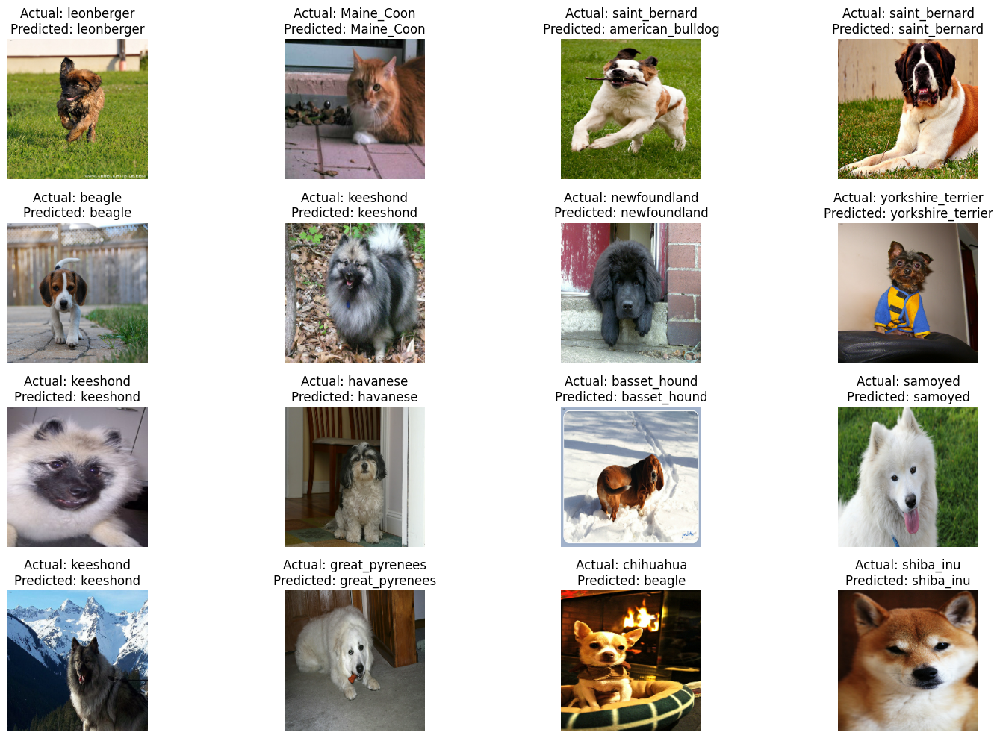

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

get_label_name = info.features['label'].int2str

for images, labels in test_ds.take(1):  # Take one batch for visualization
    batch_size = images.shape[0]
    class_names = [str(i) for i in range(37)]  # Assuming 37 classes

    # Make predictions on the batch
    predictions = model_resnet.predict(images)
    predicted_labels = np.argmax(predictions, axis=1)

    # Plot images with actual and predicted labels
    plt.figure(figsize=(16, 10))
    for i in range(16):
        normalized_image = (images[i] - tf.reduce_min(images[i])) / (tf.reduce_max(images[i]) - tf.reduce_min(images[i]))
        plt.subplot(4, 4, i + 1)
        plt.imshow(normalized_image)  # Rescale image back to [0, 1] range
        plt.title(f"Actual: {get_label_name(int(class_names[np.argmax(labels[i])]))}\nPredicted: {get_label_name(int(class_names[predicted_labels[i]]))}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

### **visualize layers**

1/1 [==============================] - 1s 698ms/step


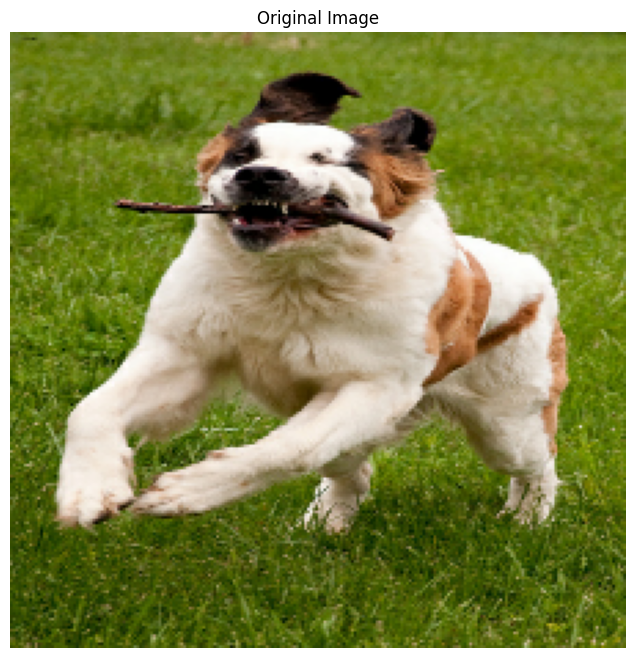

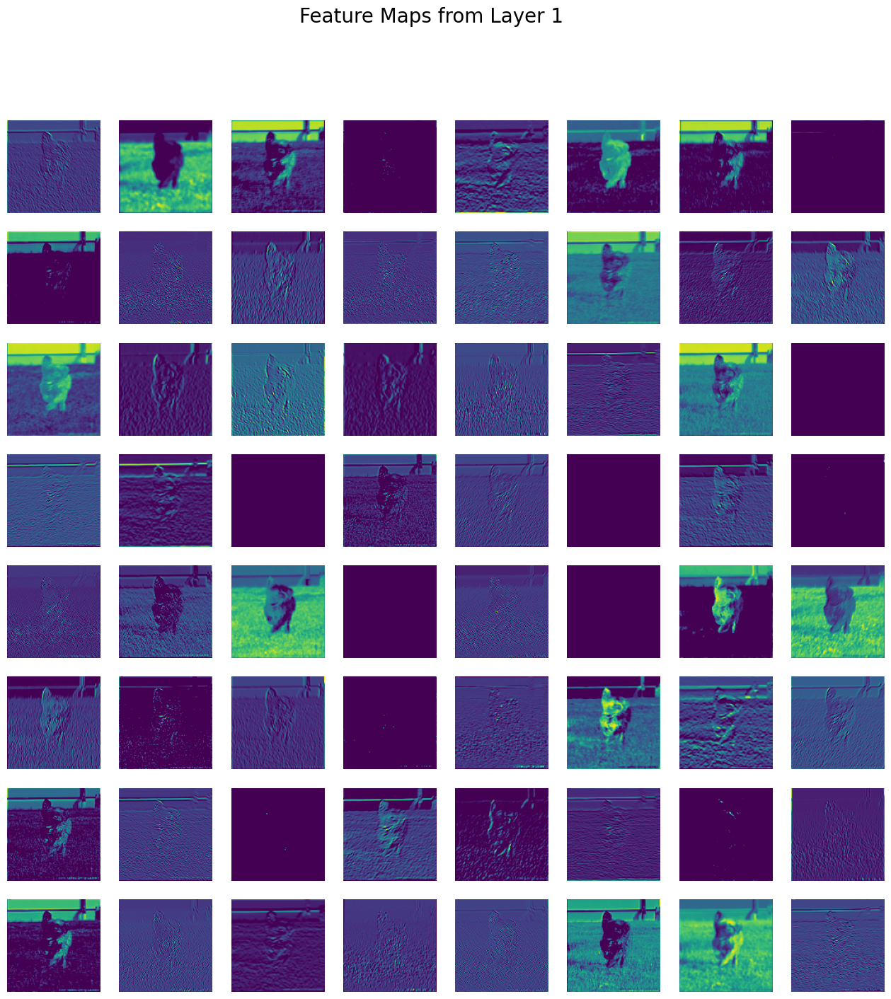

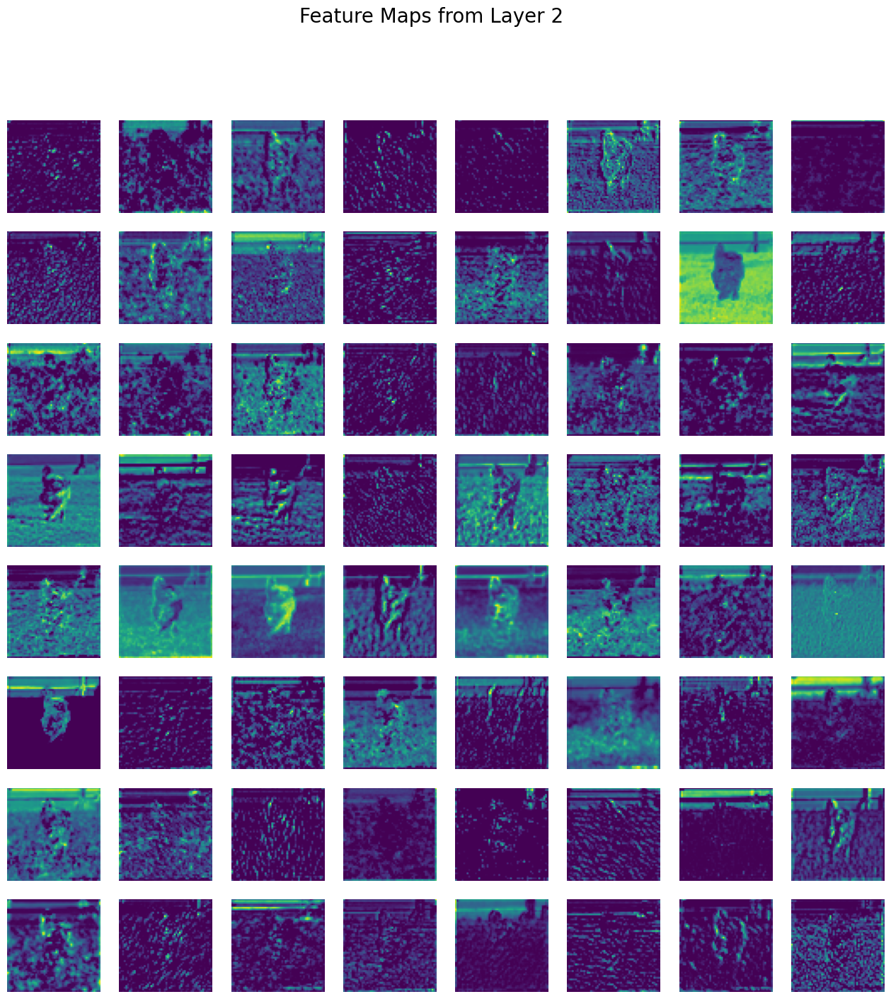

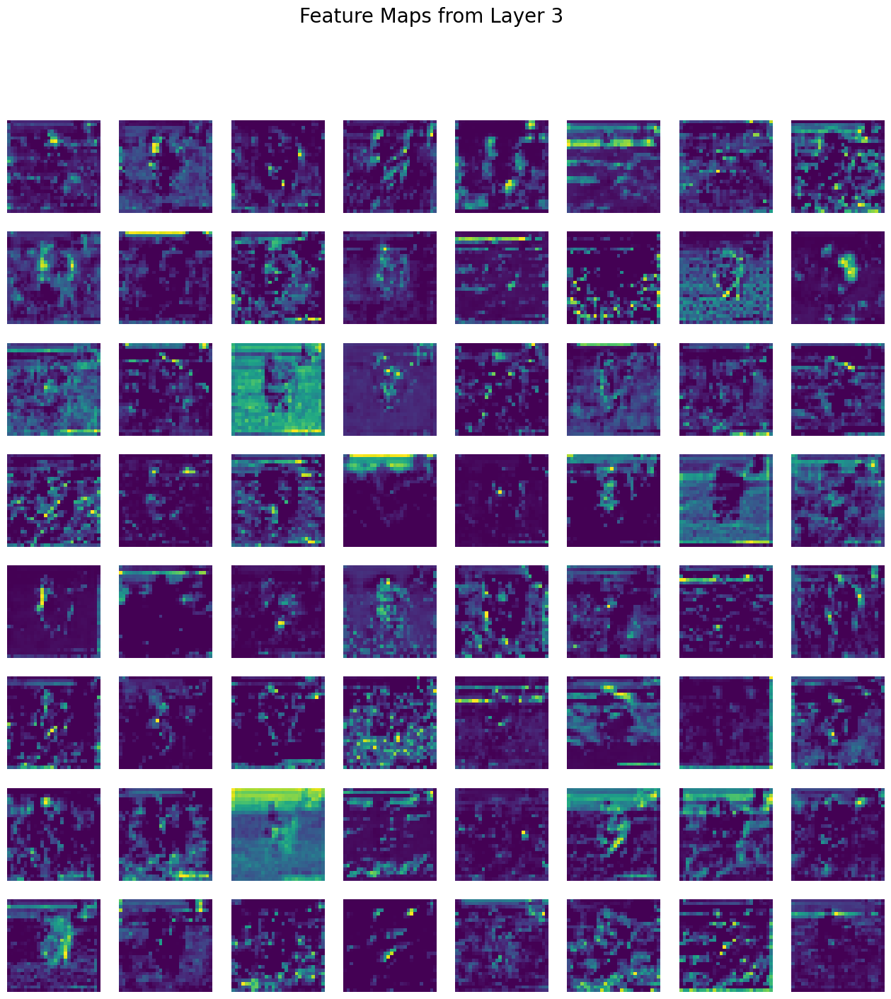

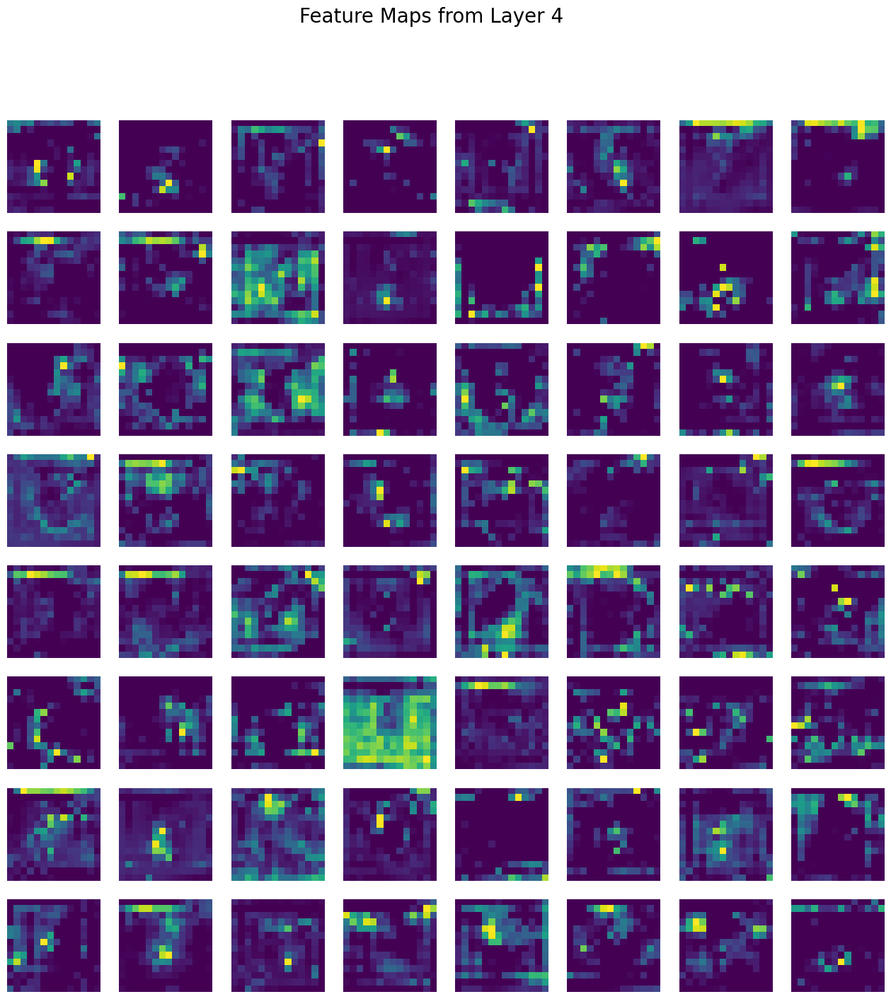

In [ ]:
import matplotlib.pyplot as plt
from tensorflow.keras import Model

layer_names = ['conv1_relu', 'conv2_block3_out', 'conv3_block4_out', 'conv4_block6_out']

modelss = [Model(inputs=resnet_base.input, outputs=resnet_base.get_layer(layer_name).output) for layer_name in layer_names]

# Take one batch of images and labels from the test dataset
for images, labels in test_ds.take(1):
    # Get predictions (feature maps) from each selected model
    predictions1 = modelss[0].predict(images)
    predictions2 = modelss[1].predict(images)
    predictions3 = modelss[2].predict(images)
    predictions4 = modelss[3].predict(images)

    # Select one image from the batch
    selected_image = images[2]

    # Display the original image
    plt.figure(figsize=(8, 8))
    plt.imshow(selected_image.numpy().astype("uint8"))
    plt.title("Original Image")
    plt.axis("off")
    plt.show()

    # Function to plot feature maps in an 8x8 grid
    def plot_feature_maps(predictions, title):
        fig, axes = plt.subplots(8, 8, figsize=(16, 16))
        fig.suptitle(title, fontsize=20)
        for i in range(8):
            for j in range(8):
                ax = axes[i, j]
                ax.imshow(predictions[0, :, :, i*8+j], cmap='viridis')
                ax.axis("off")
        plt.show()

    # Plot feature maps from the first selected layer
    plot_feature_maps(predictions1, "Feature Maps from Layer 1")

    # Plot feature maps from the second selected layer
    plot_feature_maps(predictions2, "Feature Maps from Layer 2")

    # Plot feature maps from the third selected layer
    plot_feature_maps(predictions3, "Feature Maps from Layer 3")

    # Plot feature maps from the fourth selected layer
    plot_feature_maps(predictions4, "Feature Maps from Layer 4")

    break  # Stop after the first batch


## **MobileNet**

In [ ]:
from tensorflow.keras import layers, models

mobilenet_base = MobileNetV2(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
mobilenet_base.trainable = False

model_mobilenet = models.Sequential([
    mobilenet_base,
    layers.GlobalAveragePooling2D(),
    layers.Dense(512,activation='relu'),
    layers.BatchNormalization(),
    layers.Dropout(0.2),
    layers.Dense(37,activation='softmax')
])

model_mobilenet.compile(optimizer=keras.optimizers.Adam(),
              loss='categorical_crossentropy',
              metrics=['CategoricalAccuracy'])

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history_mobilenet = model_mobilenet.fit(train_ds_augmented,
                                  epochs=25,
                                  validation_data=val_ds,
                                  callbacks=[early_stopping])

9406464/9406464 [==============================] - 0s 0us/step
Epoch 1/25
104/104 [==============================] - 52s 440ms/step - loss: 3.7990 - categorical_accuracy: 0.0782 - val_loss: 3.7574 - val_categorical_accuracy: 0.0598
Epoch 2/25
104/104 [==============================] - 46s 446ms/step - loss: 3.2956 - categorical_accuracy: 0.1335 - val_loss: 3.8387 - val_categorical_accuracy: 0.0707
Epoch 3/25
104/104 [==============================] - 48s 459ms/step - loss: 3.1533 - categorical_accuracy: 0.1597 - val_loss: 3.6278 - val_categorical_accuracy: 0.0924
Epoch 4/25
104/104 [==============================] - 47s 444ms/step - loss: 3.0350 - categorical_accuracy: 0.1772 - val_loss: 3.6181 - val_categorical_accuracy: 0.0788
Epoch 5/25
104/104 [==============================] - 48s 461ms/step - loss: 3.0019 - categorical_accuracy: 0.1926 - val_loss: 3.5975 - val_categorical_accuracy: 0.0897
Epoch 6/25
104/104 [==============================] - 48s 458ms/step - loss: 2.9137 - catego

In [ ]:
test_loss, test_accuracy = model_mobilenet.evaluate(test_ds)

print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

115/115 [==============================] - 11s 98ms/step - loss: 3.5964 - categorical_accuracy: 0.1126
Test Loss: 3.596416711807251
Test Accuracy: 0.11256473511457443


In [ ]:
for layer in mobilenet_base.layers[-15:]:
    if not isinstance(layer, layers.BatchNormalization):
        layer.trainable = True

model_mobilenet.compile(optimizer=keras.optimizers.Adam(learning_rate=1e-5), # Set a very low learning rate
              loss='categorical_crossentropy',
              metrics=['CategoricalAccuracy']
             )

history_mobilenet_2 = model_mobilenet.fit(train_ds_augmented,
                      epochs=5,
                      validation_data=val_ds)

Epoch 1/5
104/104 [==============================] - 50s 446ms/step - loss: 2.5067 - categorical_accuracy: 0.3013 - val_loss: 3.2409 - val_categorical_accuracy: 0.1440
Epoch 2/5
104/104 [==============================] - 45s 437ms/step - loss: 2.5200 - categorical_accuracy: 0.2920 - val_loss: 3.2416 - val_categorical_accuracy: 0.1522
Epoch 3/5
104/104 [==============================] - 47s 449ms/step - loss: 2.5149 - categorical_accuracy: 0.2962 - val_loss: 3.2415 - val_categorical_accuracy: 0.1630
Epoch 4/5
104/104 [==============================] - 45s 431ms/step - loss: 2.4710 - categorical_accuracy: 0.3025 - val_loss: 3.2397 - val_categorical_accuracy: 0.1630
Epoch 5/5
104/104 [==============================] - 47s 448ms/step - loss: 2.4939 - categorical_accuracy: 0.3016 - val_loss: 3.2460 - val_categorical_accuracy: 0.1495


In [ ]:
test_loss, test_accuracy = model_mobilenet.evaluate(test_ds)

print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

115/115 [==============================] - 9s 79ms/step - loss: 3.5338 - categorical_accuracy: 0.1191
Test Loss: 3.5337610244750977
Test Accuracy: 0.11910602450370789


1/1 [==============================] - 0s 30ms/step


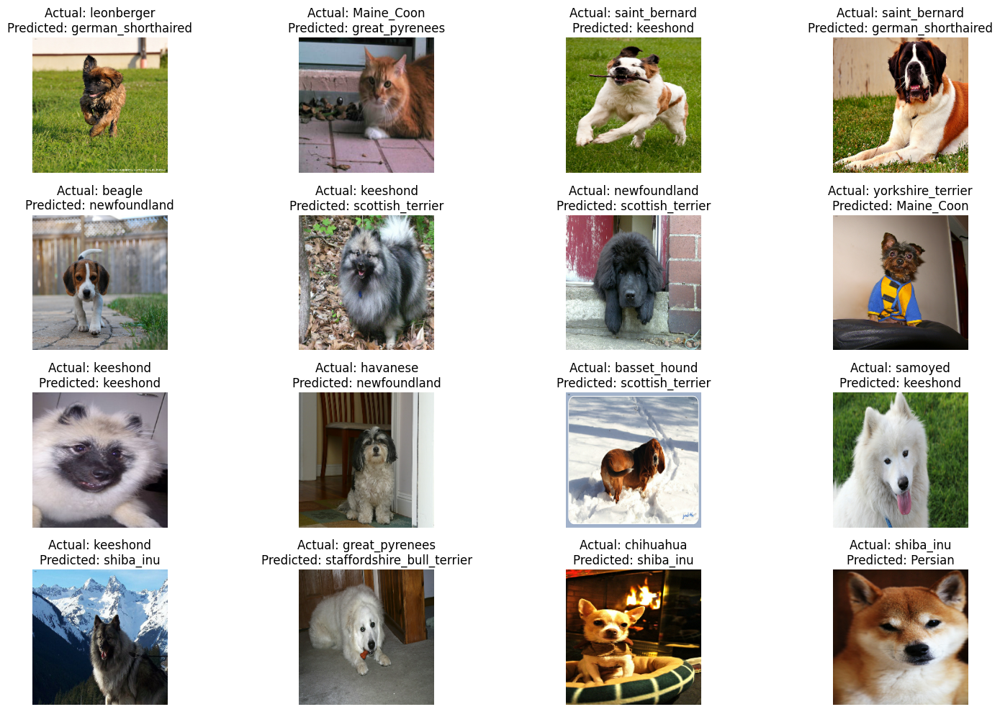

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

get_label_name = info.features['label'].int2str

for images, labels in test_ds.take(1):  # Take one batch for visualization
    batch_size = images.shape[0]
    class_names = [str(i) for i in range(37)]  # Assuming 37 classes

    # Make predictions on the batch
    predictions = model_mobilenet.predict(images)
    predicted_labels = np.argmax(predictions, axis=1)

    # Plot images with actual and predicted labels
    plt.figure(figsize=(16, 10))
    for i in range(16):
        normalized_image = (images[i] - tf.reduce_min(images[i])) / (tf.reduce_max(images[i]) - tf.reduce_min(images[i]))
        plt.subplot(4, 4, i + 1)
        plt.imshow(normalized_image)  # Rescale image back to [0, 1] range
        plt.title(f"Actual: {get_label_name(int(class_names[np.argmax(labels[i])]))}\nPredicted: {get_label_name(int(class_names[predicted_labels[i]]))}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

### **Visualizing Layers**

1/1 [==============================] - 0s 173ms/step


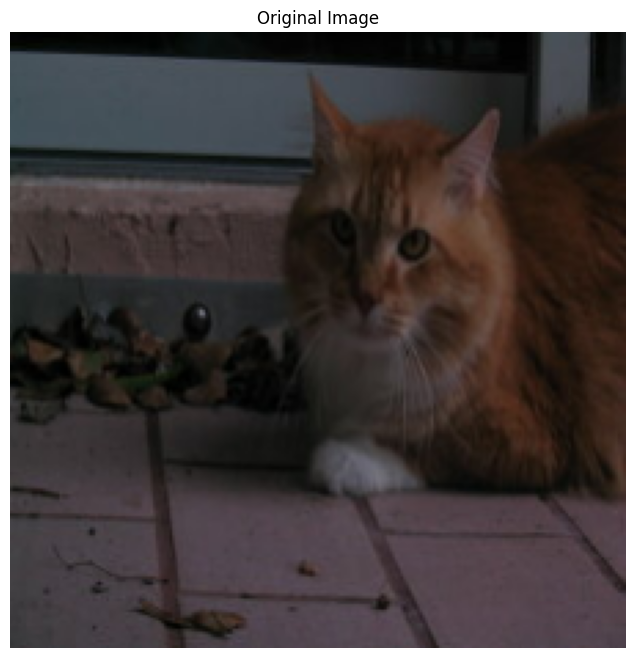

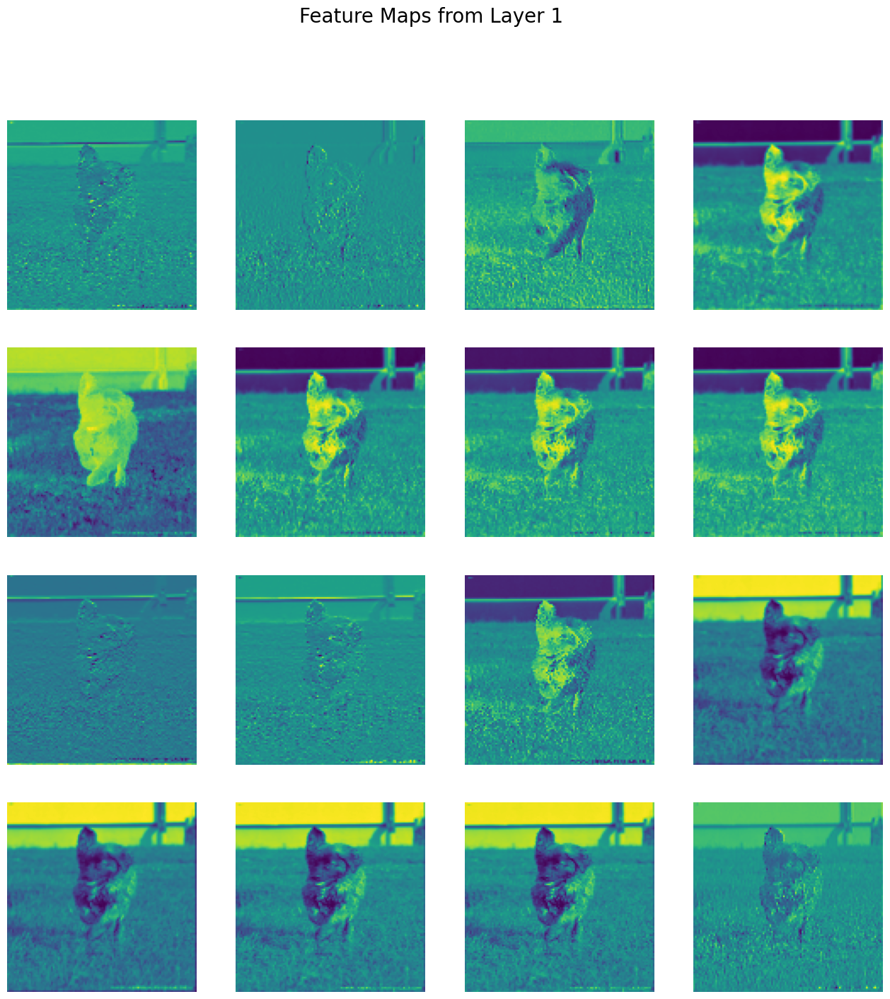

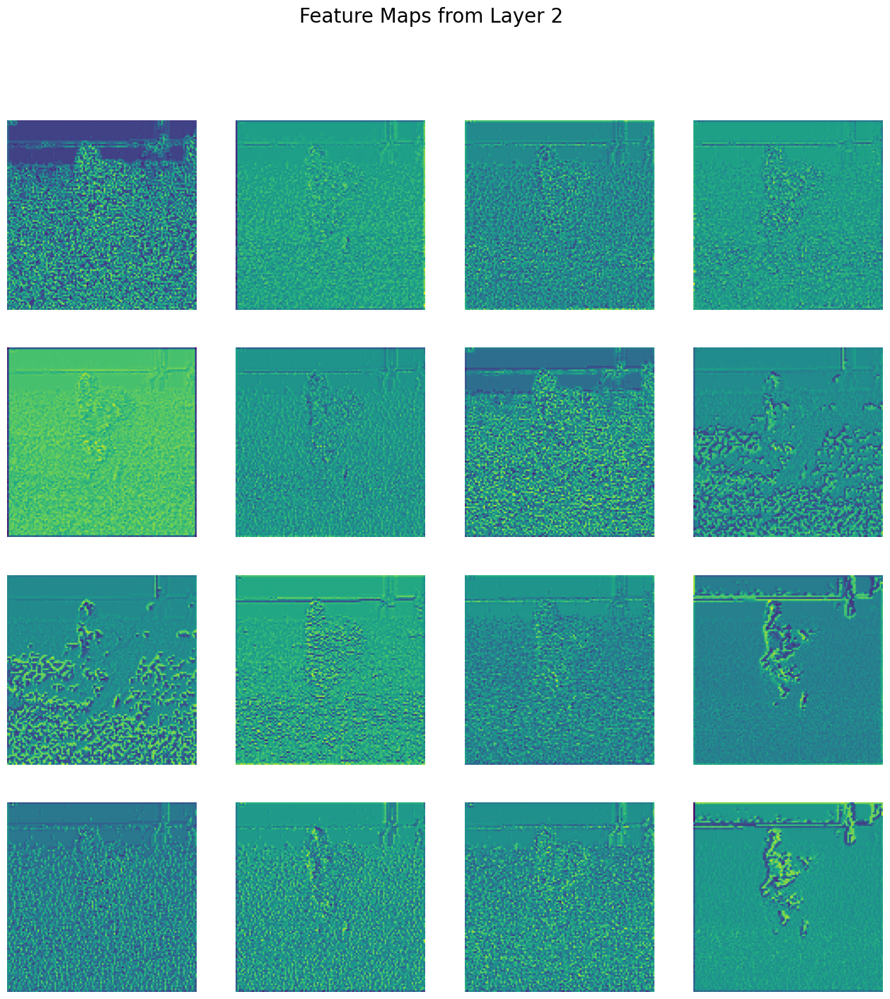

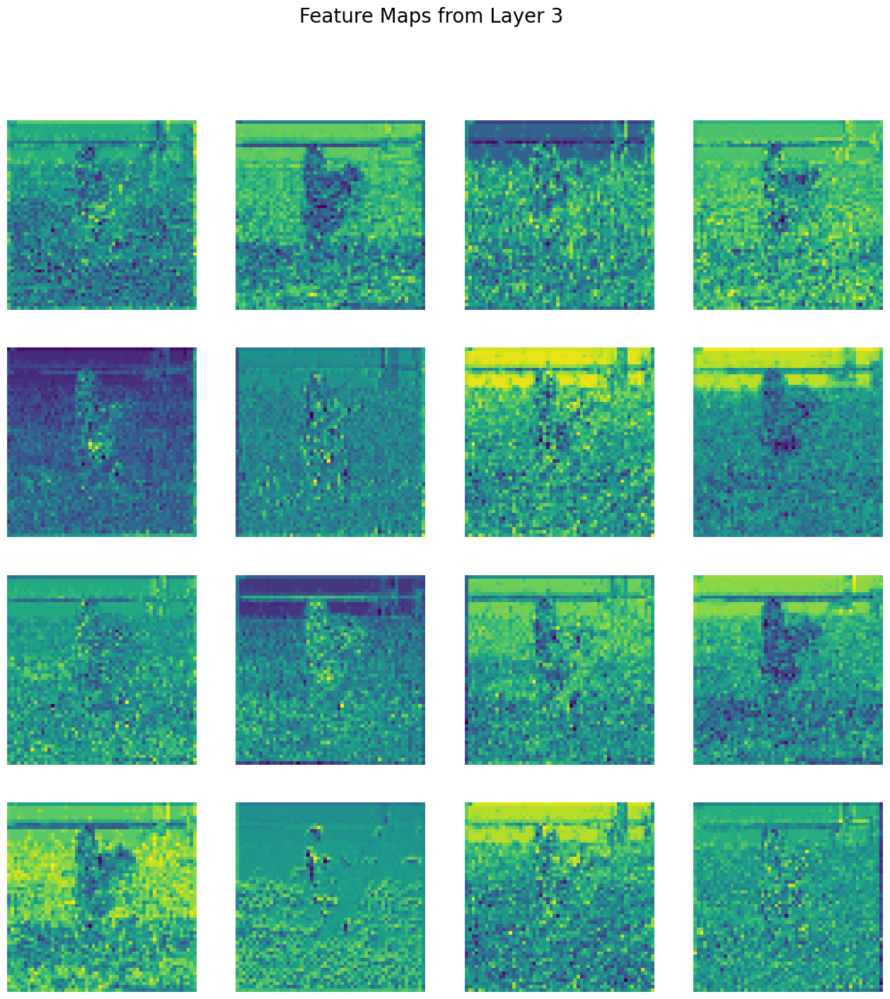

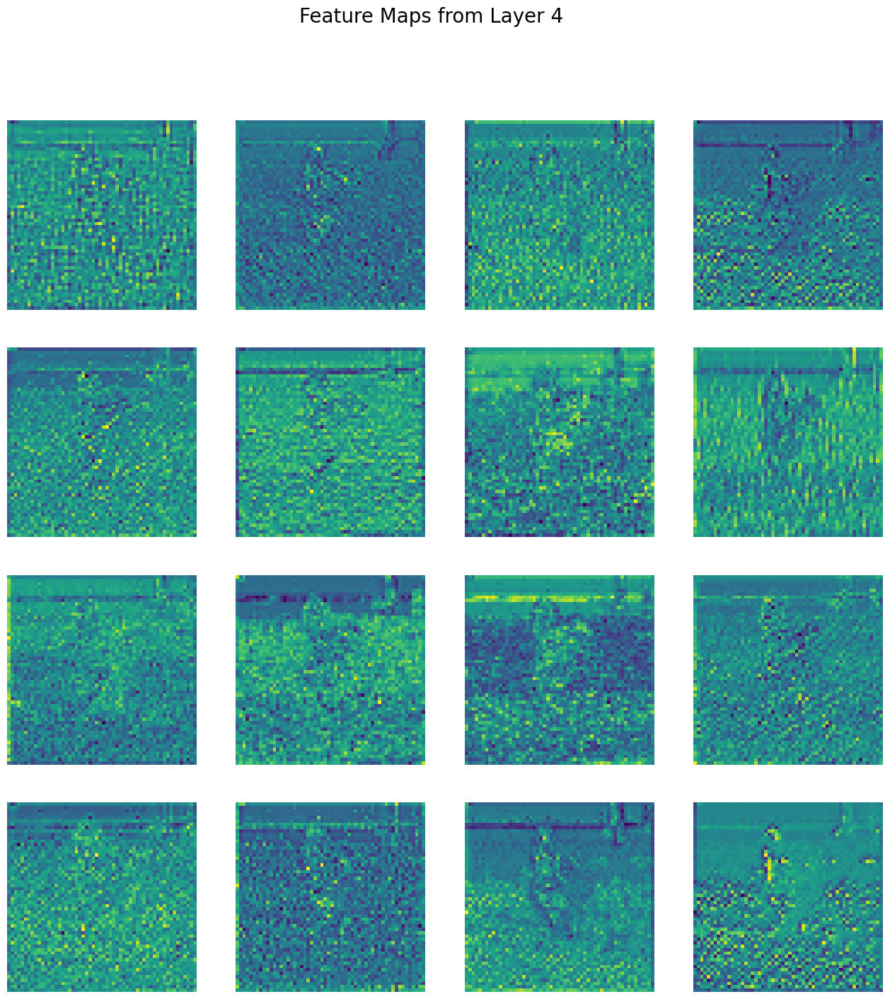

In [ ]:
import matplotlib.pyplot as plt

layer_names = ['Conv1', 'conv2_block3_out', 'conv3_block4_out', 'conv4_block6_out']

modelss = [Model(inputs=mobilenet_base.input, outputs=mobilenet_base.get_layer(layer_name).output) for layer_name in layer_names]

# Take one batch of images and labels from the test dataset
for images, labels in test_ds.take(1):
    # Get predictions (feature maps) from each selected model
    predictions1 = modelss[0].predict(images)
    predictions2 = modelss[1].predict(images)
    predictions3 = modelss[2].predict(images)
    predictions4 = modelss[3].predict(images)

    # Select one image from the batch
    selected_image = images[0]

    # Display the original image
    plt.figure(figsize=(8, 8))
    plt.imshow(selected_image.numpy().astype("uint8"))
    plt.title("Original Image")
    plt.axis("off")
    plt.show()

    # Function to plot feature maps in an 8x8 grid
    def plot_feature_maps(predictions, title):
        fig, axes = plt.subplots(8, 8, figsize=(16, 16))
        fig.suptitle(title, fontsize=20)
        for i in range(8):
            for j in range(8):
                ax = axes[i, j]
                ax.imshow(predictions[0, :, :, i*8+j], cmap='viridis')
                ax.axis("off")
        plt.show()

    # Plot feature maps from the first selected layer
    plot_feature_maps(predictions1, "Feature Maps from Layer 1")

    # Plot feature maps from the second selected layer
    plot_feature_maps(predictions2, "Feature Maps from Layer 2")

    # Plot feature maps from the third selected layer
    plot_feature_maps(predictions3, "Feature Maps from Layer 3")

    # Plot feature maps from the fourth selected layer
    plot_feature_maps(predictions4, "Feature Maps from Layer 4")

    break  # Stop after the first batch


## **GoogleNet (Inception)**

In [12]:
from tensorflow.keras import layers, models
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam ,RMSprop, SGD
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow import keras

inception_base = InceptionV3(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
inception_base.trainable = False

model_inception = models.Sequential([
    inception_base,
    layers.GlobalAveragePooling2D(),
    layers.Dense(512,activation='relu'),
    layers.BatchNormalization(),
    layers.Dropout(0.2),
    layers.Dense(512,activation='relu'),
    layers.BatchNormalization(),
    layers.Dropout(0.2),
    layers.Dense(37,activation='softmax')
])

model_inception.compile(optimizer=keras.optimizers.Adam(),
              loss='categorical_crossentropy',
              metrics=['CategoricalAccuracy'])

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history_inception = model_inception.fit(train_ds_augmented,
                                  epochs=25,
                                  validation_data=val_ds,
                                  callbacks=[early_stopping])

Epoch 1/25
104/104 [==============================] - 59s 504ms/step - loss: 4.0616 - categorical_accuracy: 0.0543 - val_loss: 5.0650 - val_categorical_accuracy: 0.0788
Epoch 2/25
104/104 [==============================] - 50s 482ms/step - loss: 3.7543 - categorical_accuracy: 0.0704 - val_loss: 3.5846 - val_categorical_accuracy: 0.0951
Epoch 3/25
104/104 [==============================] - 50s 483ms/step - loss: 3.6700 - categorical_accuracy: 0.0752 - val_loss: 3.5157 - val_categorical_accuracy: 0.0951
Epoch 4/25
104/104 [==============================] - 51s 487ms/step - loss: 3.6128 - categorical_accuracy: 0.0749 - val_loss: 3.4417 - val_categorical_accuracy: 0.1033
Epoch 5/25
104/104 [==============================] - 51s 488ms/step - loss: 3.5632 - categorical_accuracy: 0.0891 - val_loss: 3.5812 - val_categorical_accuracy: 0.0734
Epoch 6/25
104/104 [==============================] - 52s 505ms/step - loss: 3.5276 - categorical_accuracy: 0.0906 - val_loss: 3.4251 - val_categorical_acc

In [17]:
test_ds = test_ds.batch(32)

test_loss, test_accuracy = model_inception.evaluate(test_ds)

print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

115/115 [==============================] - 11s 95ms/step - loss: 3.3193 - categorical_accuracy: 0.1142
Test Loss: 3.319345474243164
Test Accuracy: 0.11420005559921265


1/1 [==============================] - 1s 1s/step


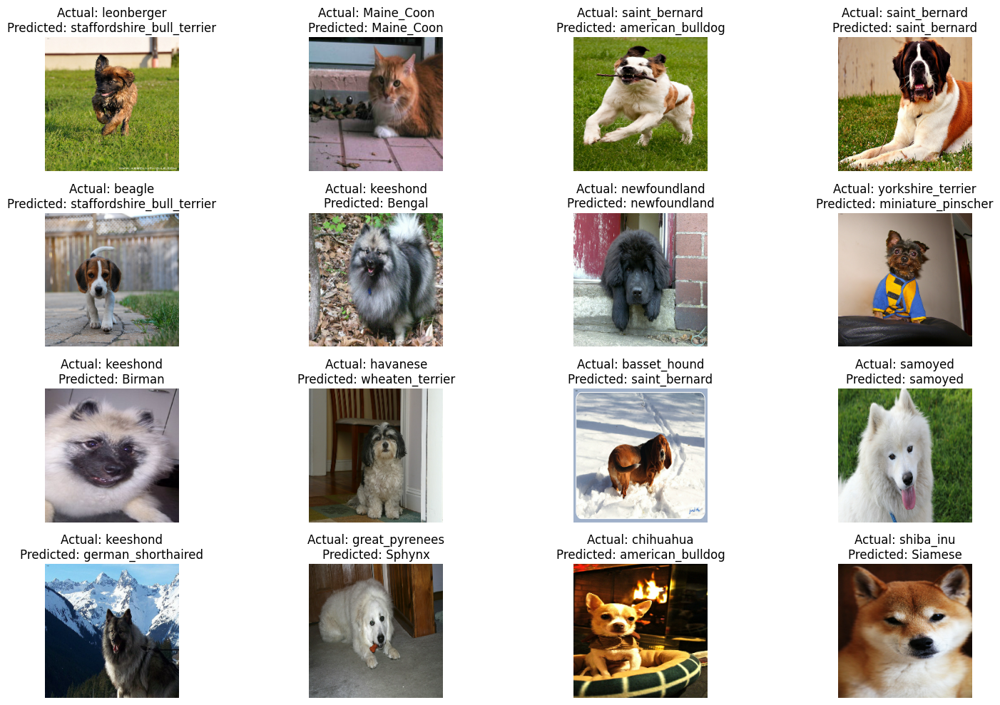

In [24]:
import matplotlib.pyplot as plt
import numpy as np

get_label_name = info.features['label'].int2str

for images, labels in test_ds.take(1):  # Take one batch for visualization
    batch_size = images.shape[0]
    class_names = [str(i) for i in range(37)]  # Assuming 37 classes

    # Make predictions on the batch
    predictions = model_inception.predict(images)
    predicted_labels = np.argmax(predictions, axis=1)

    # Plot images with actual and predicted labels
    plt.figure(figsize=(16, 10))
    for i in range(16):
        normalized_image = (images[i] - tf.reduce_min(images[i])) / (tf.reduce_max(images[i]) - tf.reduce_min(images[i]))
        plt.subplot(4, 4, i + 1)
        plt.imshow(normalized_image)  # Rescale image back to [0, 1] range
        plt.title(f"Actual: {get_label_name(int(class_names[np.argmax(labels[i])]))}\nPredicted: {get_label_name(int(class_names[predicted_labels[i]]))}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

### **Visualizing Layers**

1/1 [==============================] - 0s 80ms/step


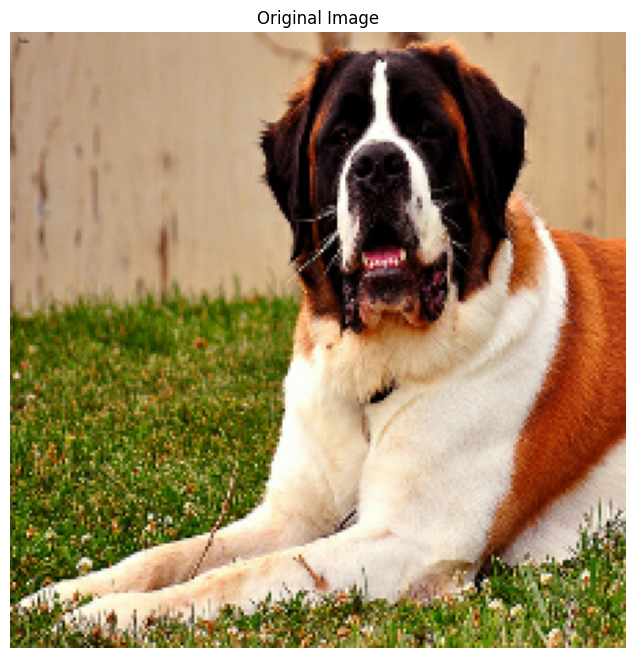

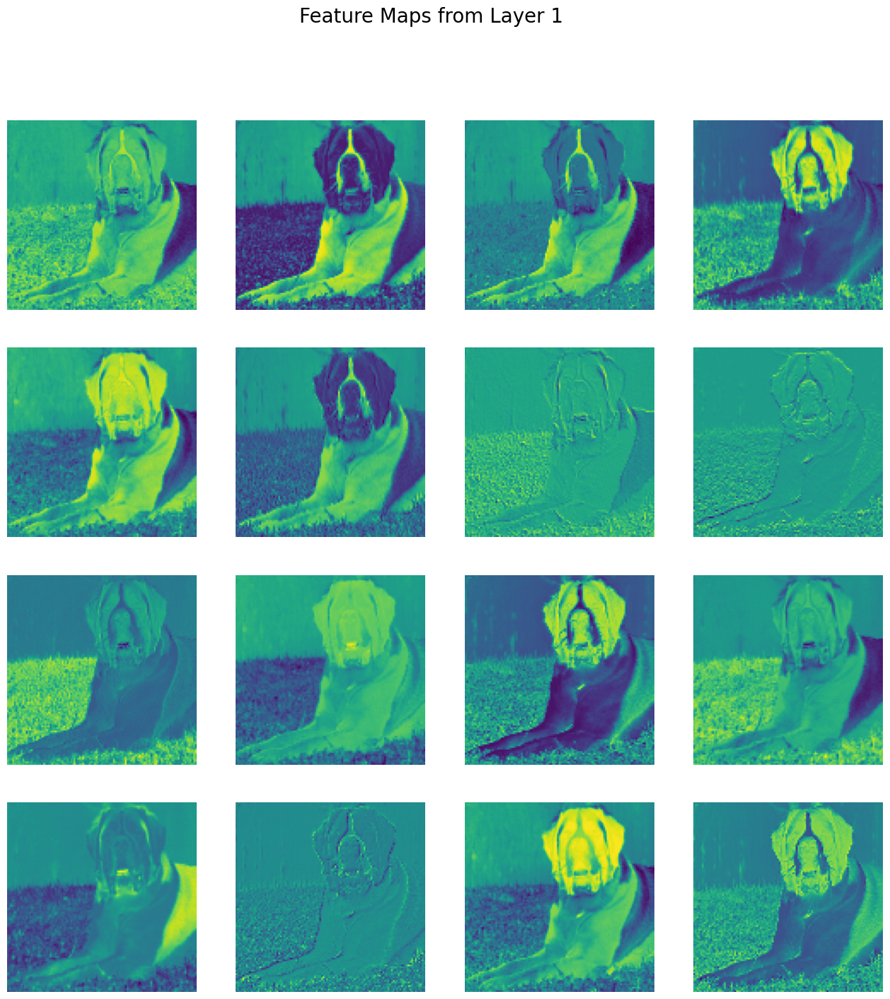

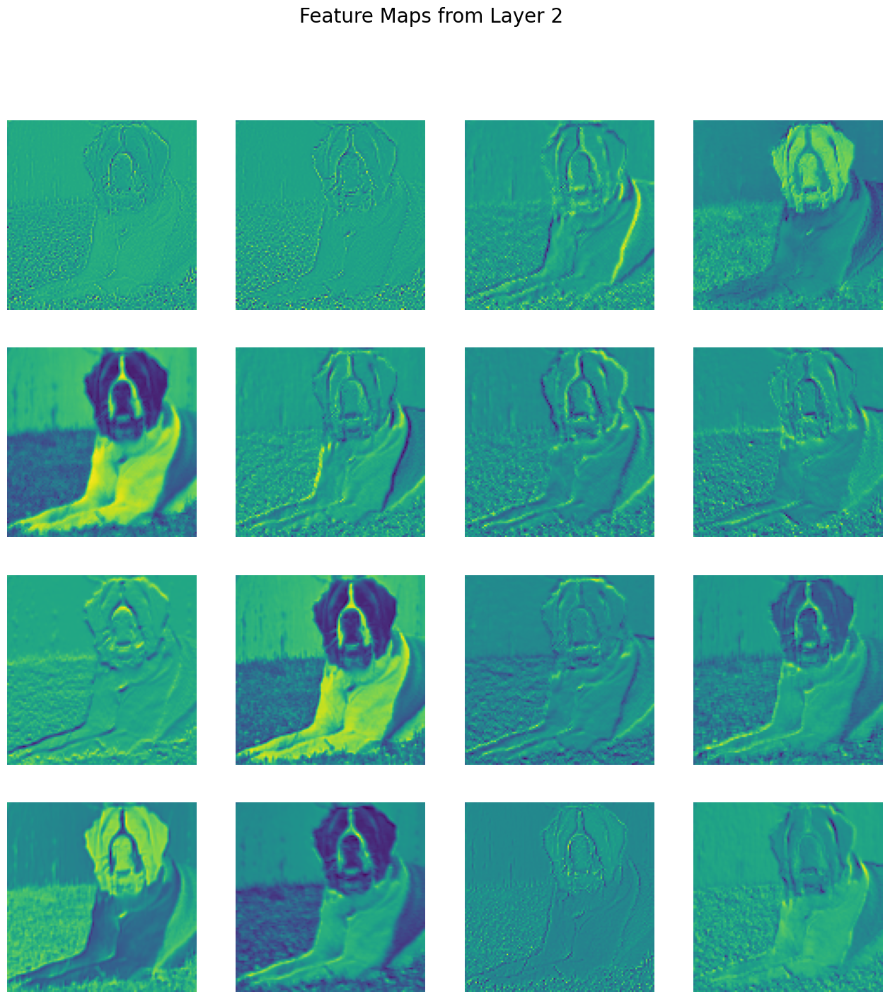

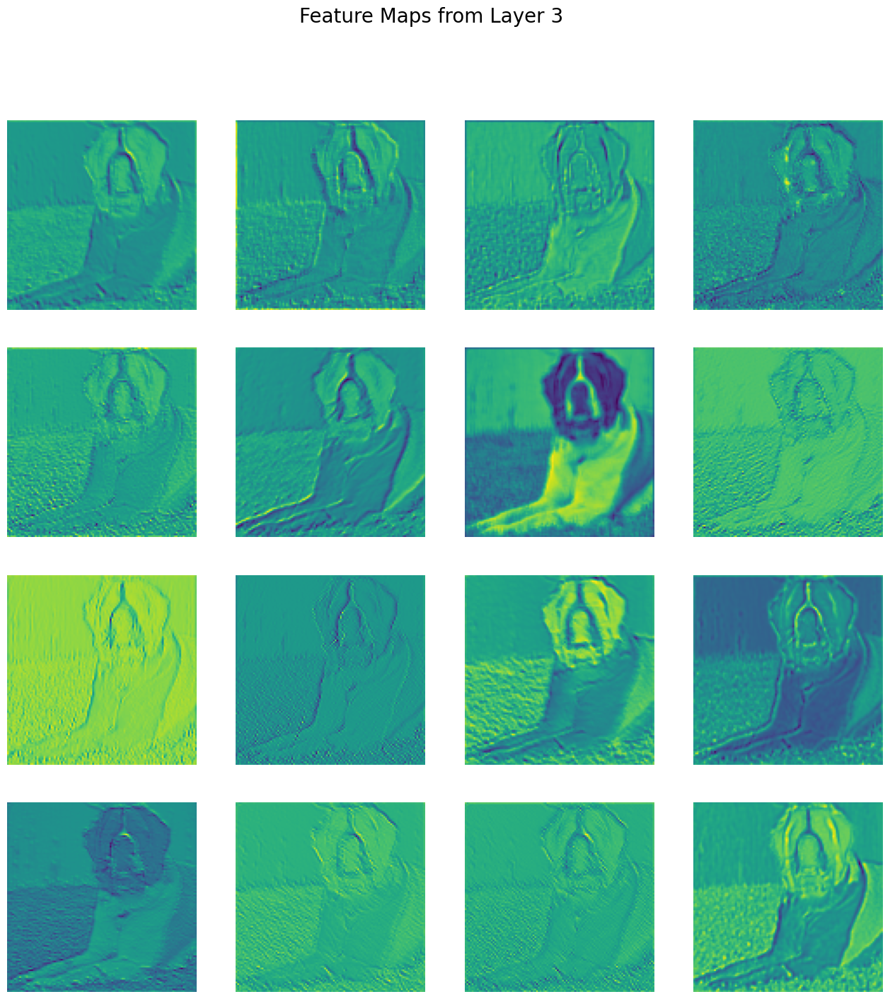

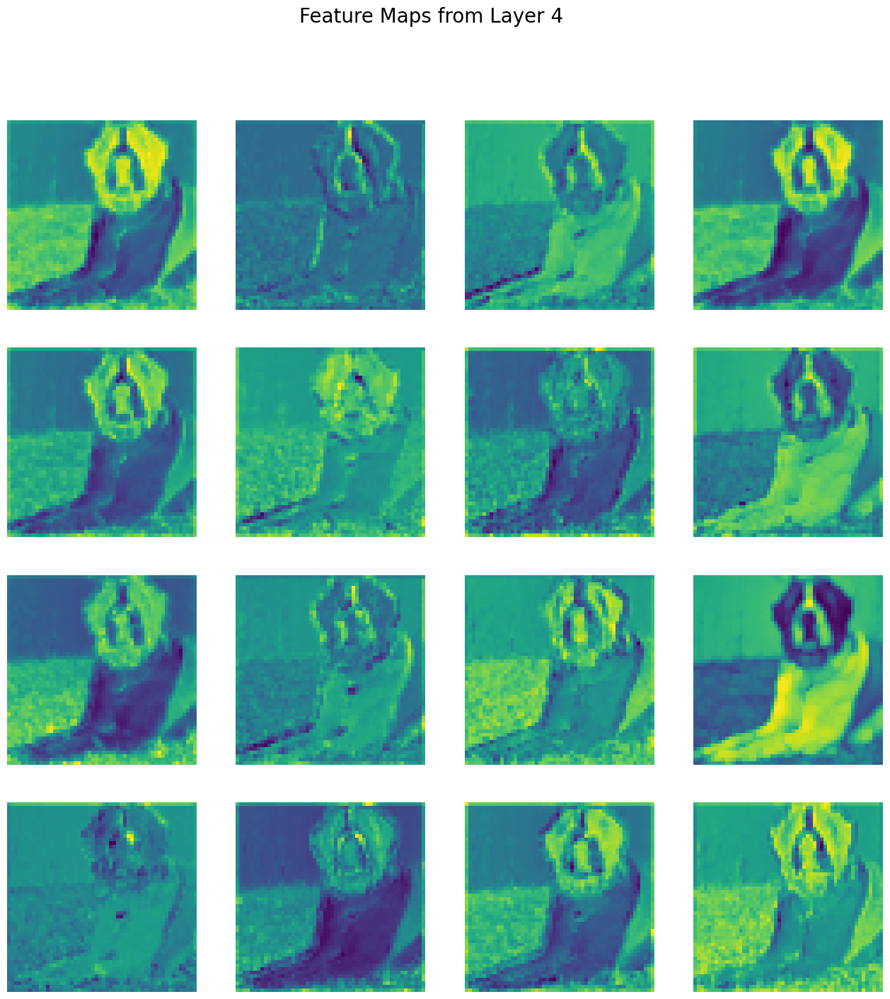

In [30]:
import matplotlib.pyplot as plt
from tensorflow.keras import Model

layer_names = ['conv2d_282', 'conv2d_283', 'conv2d_284', 'conv2d_285']

modelss = [Model(inputs=inception_base.input, outputs=inception_base.get_layer(layer_name).output) for layer_name in layer_names]

# Take one batch of images and labels from the test dataset
for images, labels in test_ds.take(1):
    # Get predictions (feature maps) from each selected model
    predictions1 = modelss[0].predict(images)
    predictions2 = modelss[1].predict(images)
    predictions3 = modelss[2].predict(images)
    predictions4 = modelss[3].predict(images)

    # Select one image from the batch
    selected_image = images[3]

    # Display the original image
    plt.figure(figsize=(8, 8))
    plt.imshow(selected_image.numpy().astype("uint8"))
    plt.title("Original Image")
    plt.axis("off")
    plt.show()

    # Function to plot feature maps in an 8x8 grid
    def plot_feature_maps(predictions, title):
        fig, axes = plt.subplots(4, 4, figsize=(16, 16))
        fig.suptitle(title, fontsize=20)
        for i in range(4):
            for j in range(4):
                ax = axes[i, j]
                ax.imshow(predictions[3, :, :, i*4+j], cmap='viridis')
                ax.axis("off")
        plt.show()

    # Plot feature maps from the first selected layer
    plot_feature_maps(predictions1, "Feature Maps from Layer 1")

    # Plot feature maps from the second selected layer
    plot_feature_maps(predictions2, "Feature Maps from Layer 2")

    # Plot feature maps from the third selected layer
    plot_feature_maps(predictions3, "Feature Maps from Layer 3")

    # Plot feature maps from the fourth selected layer
    plot_feature_maps(predictions4, "Feature Maps from Layer 4")

    break  # Stop after the first batch
